<a href="https://colab.research.google.com/github/dbtmddn41/deep_learning/blob/main/practice/explain_cnn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# 1. 활성화 맵 시각화

In [ ]:
model = keras.applications.vgg16.VGG16(weights='imagenet', include_top=False, input_shape=(180,180,3))
model.summary()

58889256/58889256 [==============================] - 1s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 180, 180, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 180, 180, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 90, 90, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 90, 90, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 90, 90, 128)       147584    
                                                              

In [ ]:
import numpy as np

img_path = keras.utils.get_file(fname='macbook.jpg', origin='https://www.itworld.co.kr/files/itworld/ITW_202207_01/14-inch-macbook-pro-2-100912448-orig-1-jpg.webp')

def get_img_array(img_path, target_size):
    img_array = keras.utils.img_to_array(keras.utils.load_img(img_path, target_size=target_size))
    img_array = np.expand_dims(img_array, axis=0)
    return img_array

img_tensor = get_img_array(img_path, (180, 180))

30526/30526 [==============================] - 0s 5us/step


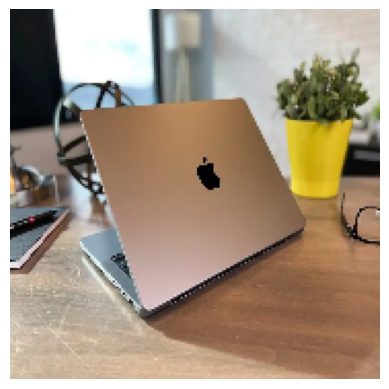

In [ ]:
import matplotlib.pyplot as plt

plt.axis("off")
plt.imshow(img_tensor[0].astype('uint8'))
plt.show()

In [ ]:
layer_outputs = []
layer_names = []

for layer in model.layers:
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)
activation_model = keras.Model(inputs=model.input, outputs=layer_outputs)

In [ ]:
activations = activation_model.predict(img_tensor)

1/1 [==============================] - 9s 9s/step


In [ ]:
print(*list(zip(layer_outputs, layer_names)), sep='\n')

(<KerasTensor: shape=(None, 180, 180, 64) dtype=float32 (created by layer 'block1_conv1')>, 'block1_conv1')
(<KerasTensor: shape=(None, 180, 180, 64) dtype=float32 (created by layer 'block1_conv2')>, 'block1_conv2')
(<KerasTensor: shape=(None, 90, 90, 64) dtype=float32 (created by layer 'block1_pool')>, 'block1_pool')
(<KerasTensor: shape=(None, 90, 90, 128) dtype=float32 (created by layer 'block2_conv1')>, 'block2_conv1')
(<KerasTensor: shape=(None, 90, 90, 128) dtype=float32 (created by layer 'block2_conv2')>, 'block2_conv2')
(<KerasTensor: shape=(None, 45, 45, 128) dtype=float32 (created by layer 'block2_pool')>, 'block2_pool')
(<KerasTensor: shape=(None, 45, 45, 256) dtype=float32 (created by layer 'block3_conv1')>, 'block3_conv1')
(<KerasTensor: shape=(None, 45, 45, 256) dtype=float32 (created by layer 'block3_conv2')>, 'block3_conv2')
(<KerasTensor: shape=(None, 45, 45, 256) dtype=float32 (created by layer 'block3_conv3')>, 'block3_conv3')
(<KerasTensor: shape=(None, 22, 22, 256)

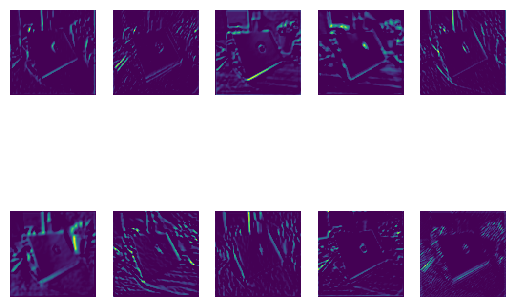

In [ ]:
layer_idx = 4
fig = plt.figure()
for i in range(1, layer_outputs[layer_idx].shape[-1]):
    ax = fig.add_subplot(2, 5, i)
    ax.axis('off')
    ax.matshow(activations[layer_idx][0, :, :, i], cmap='viridis')
    if i > 9:
        break

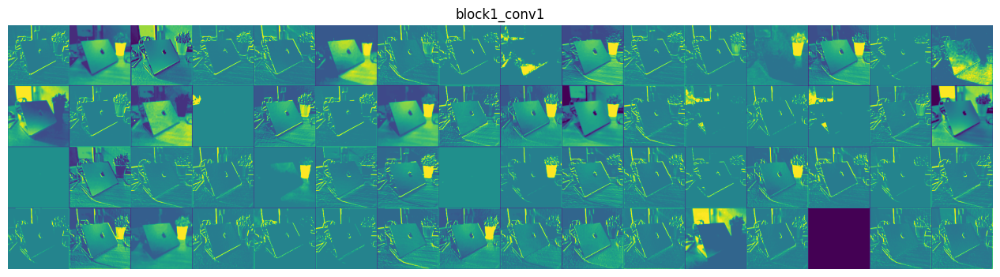

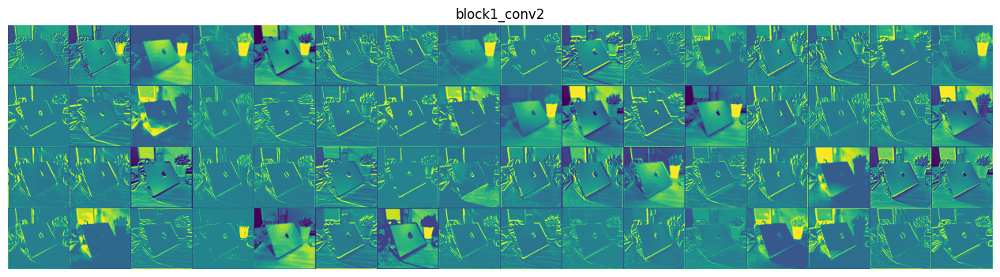

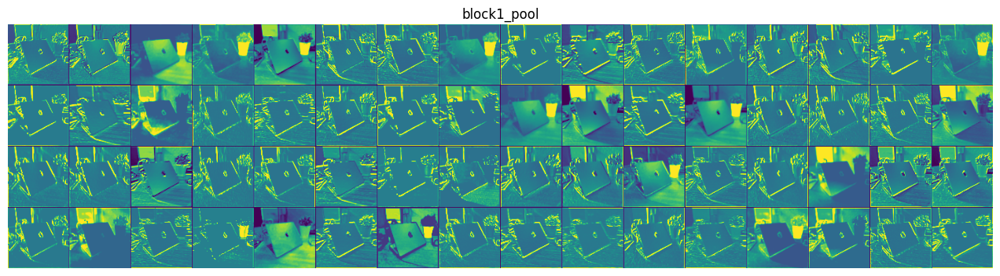

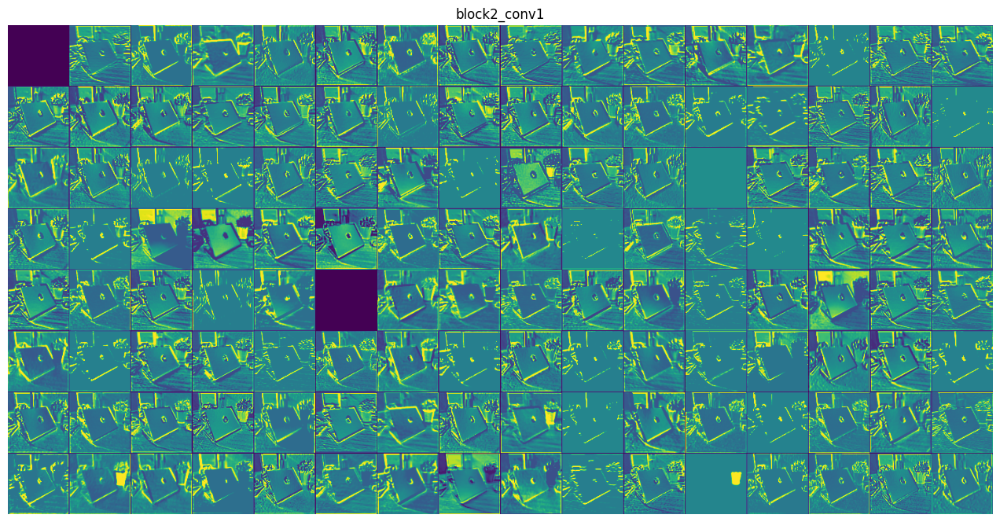

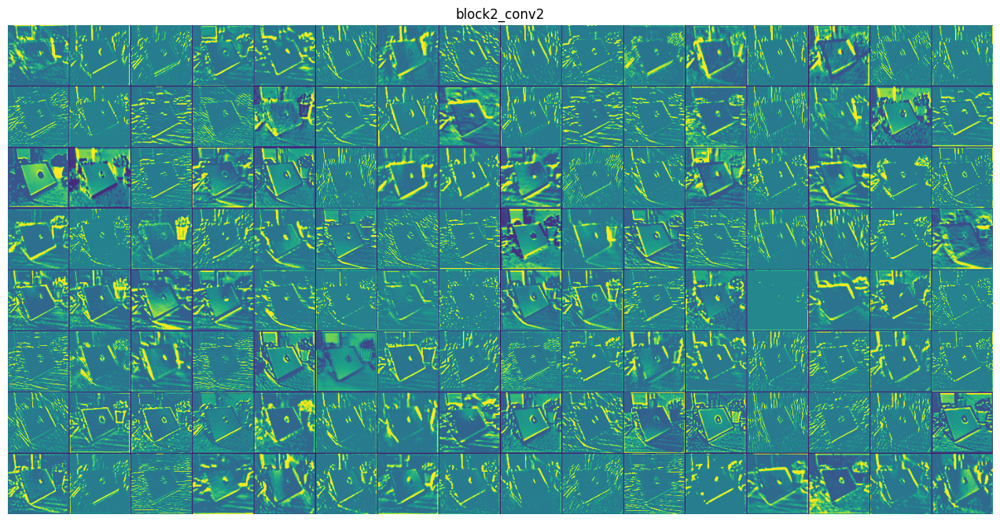

...

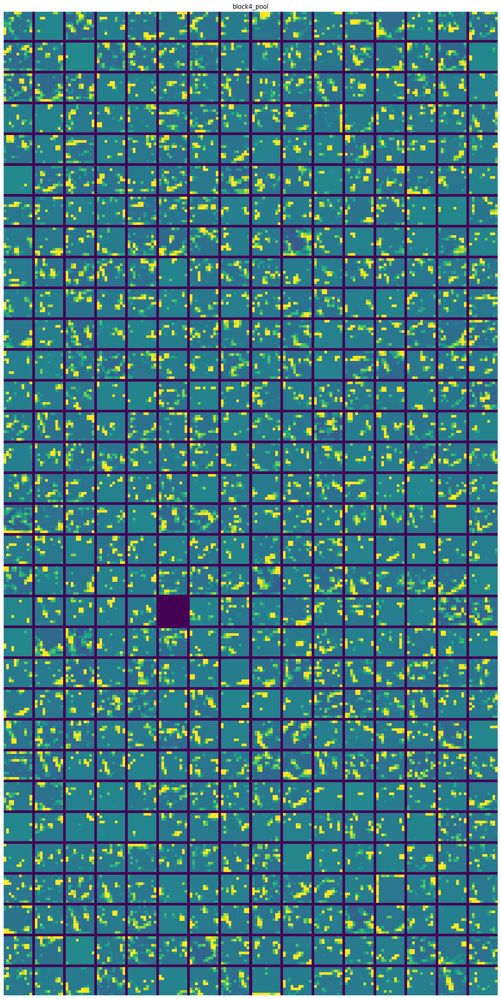

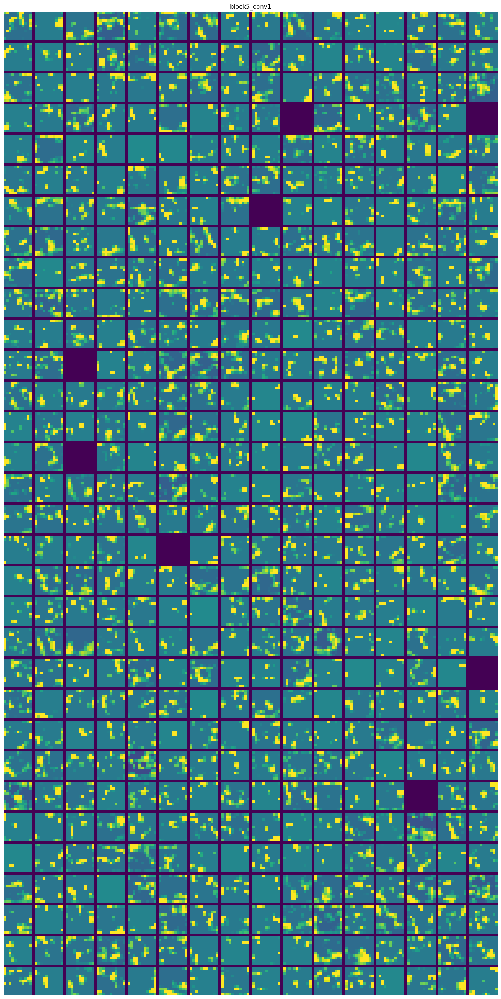

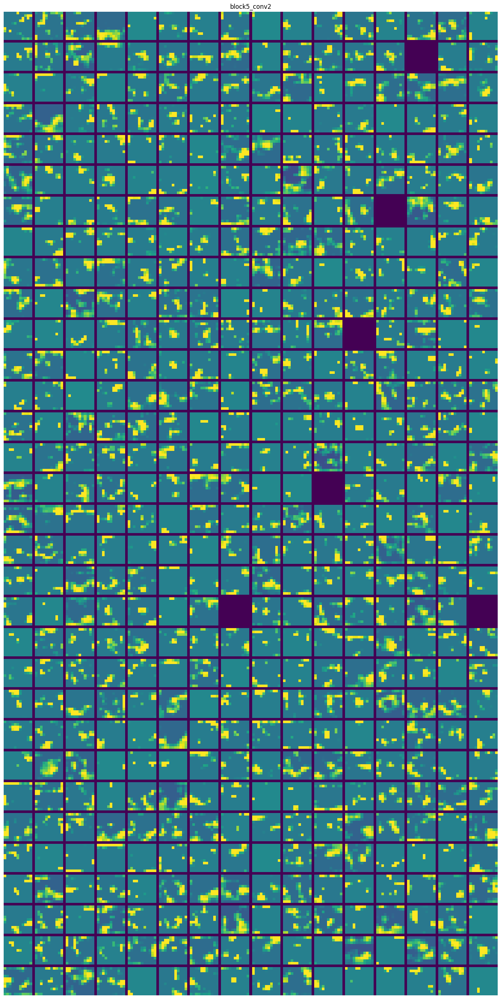

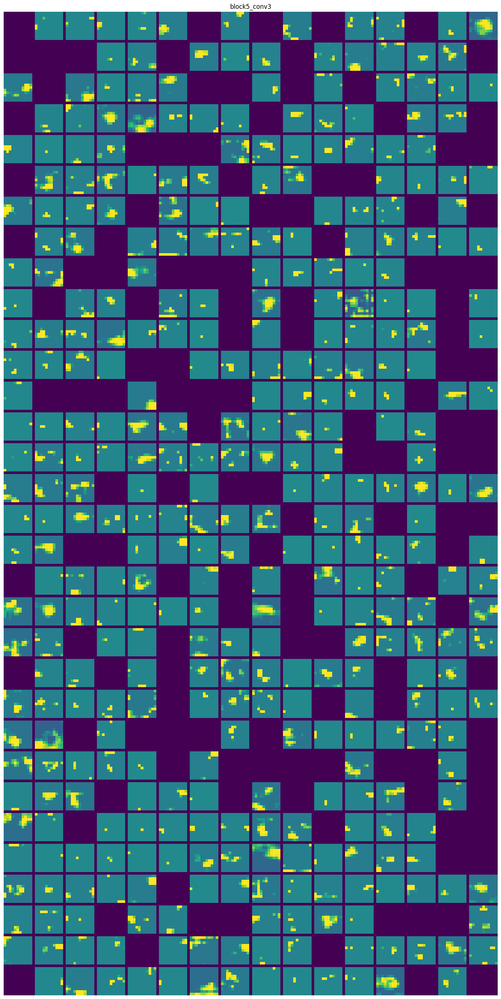

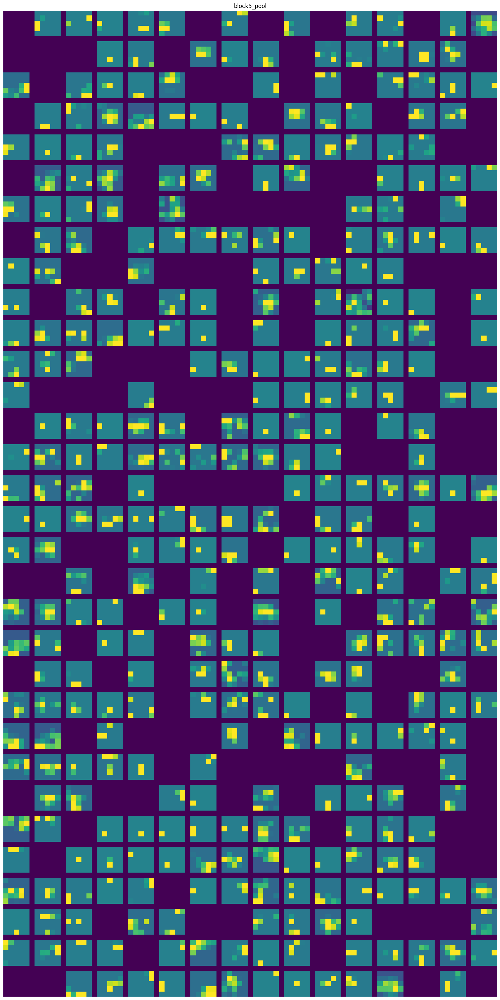

In [ ]:
image_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
    _, size, _, n_features = layer_activation.shape
    n_rows = n_features // image_per_row
    display_grid = np.zeros(((size + 1) * n_rows - 1, image_per_row * (size + 1) - 1))

    for row in range(n_rows):
        for col in range(image_per_row):
            channel_index = row * image_per_row + col
            channel_image = layer_activation[0, :, :, channel_index].copy()
            if channel_image.sum() != 0:
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[row * (size+1):row * (size+1) + size, col * (size+1):col * (size+1) + size] = channel_image
    scale = 1./size
    plt.figure(figsize=(scale*display_grid.shape[1], scale*display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.axis('off')
    plt.imshow(display_grid, aspect='auto', cmap='viridis')


# 2. 필터 활성화

In [ ]:
xception = keras.applications.xception.Xception(weights='imagenet', include_top=False)

83683744/83683744 [==============================] - 1s 0us/step


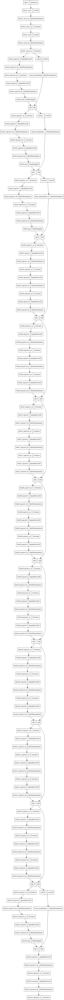

In [ ]:
keras.utils.plot_model(xception, 'xception.png')

In [ ]:
layer_name = 'block3_sepconv1'
layer = xception.get_layer(name=layer_name)
feature_extractor = keras.Model(inputs=xception.input, outputs=layer.output)

In [ ]:
avtivation = feature_extractor(keras.applications.xception.preprocess_input(img_tensor))

In [ ]:
def comput_loss(image, filter_idx):
    activation = feature_extractor(image)
    filter_activation = activation[:, 2:-2, 2:-2, filter_idx]
    return tf.reduce_mean(filter_activation)


In [ ]:
@tf.function
def gradient_ascent_step(image, filter_index, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(image)
        loss = comput_loss(image, filter_index)
    grads = tape.gradient(loss, image)
    grads = tf.math.l2_normalize(grads)
    image += learning_rate * grads
    return image

In [ ]:
img_size = (200, 200)
def generate_filter_pattern(filter_index):
    iters = 30
    learning_rate = 10.
    image = tf.random.normal(mean=0.0, stddev=0.3875, shape=(1, *img_size, 3))
    tf.clip_by_value(image, -1, 1)
    for i in range(iters):
        image = gradient_ascent_step(image, filter_index, learning_rate)
    return image[0].numpy()

In [ ]:
def deprocess_image(image):
    image -= image.mean()
    image /= image.std()
    image *= 64
    image += 128
    image = np.clip(image, 0, 255).astype('uint8')
    image = image[25:-25, 25:-25, :]
    return image

In [ ]:
all_images = []
for filter_index in range(64):
    print(f'{filter_index}번째 filter 처리 중')
    image = deprocess_image(generate_filter_pattern(filter_index))
    all_images.append(image)

margin = 5
n = 8
cropped_width = img_size[0] - 25*2
cropped_height = img_size[1] - 25*2
width = n * cropped_width + (n-1)*margin
height = n * cropped_height + (n-1)*margin
stitched_filters = np.zeros((width, height, 3))

for i in range(n):
    for j in range(n):
      image = all_images[i * n + j]
      stitched_filters[
          (cropped_width+margin)*i:(cropped_width+margin)*i+cropped_width,
          (cropped_height+margin)*j:(cropped_height+margin)*j+cropped_height, :
      ] = image

keras.utils.save_img(f'filters_for_layer_{layer_name}.png', stitched_filters)

0번째 filter 처리 중
1번째 filter 처리 중
2번째 filter 처리 중
3번째 filter 처리 중
4번째 filter 처리 중
5번째 filter 처리 중
6번째 filter 처리 중
7번째 filter 처리 중
8번째 filter 처리 중
9번째 filter 처리 중
10번째 filter 처리 중
11번째 filter 처리 중
12번째 filter 처리 중
13번째 filter 처리 중
14번째 filter 처리 중
15번째 filter 처리 중
16번째 filter 처리 중
17번째 filter 처리 중
18번째 filter 처리 중
19번째 filter 처리 중
20번째 filter 처리 중
21번째 filter 처리 중
22번째 filter 처리 중
23번째 filter 처리 중
24번째 filter 처리 중
25번째 filter 처리 중
26번째 filter 처리 중
27번째 filter 처리 중
28번째 filter 처리 중
29번째 filter 처리 중
30번째 filter 처리 중
31번째 filter 처리 중
32번째 filter 처리 중
33번째 filter 처리 중
34번째 filter 처리 중
35번째 filter 처리 중
36번째 filter 처리 중
37번째 filter 처리 중
38번째 filter 처리 중
39번째 filter 처리 중
40번째 filter 처리 중
41번째 filter 처리 중
42번째 filter 처리 중
43번째 filter 처리 중
44번째 filter 처리 중
45번째 filter 처리 중
46번째 filter 처리 중
47번째 filter 처리 중
48번째 filter 처리 중
49번째 filter 처리 중
50번째 filter 처리 중
51번째 filter 처리 중
52번째 filter 처리 중
53번째 filter 처리 중
54번째 filter 처리 중
55번째 filter 처리 중
56번째 filter 처리 중
57번째 filter 처리 중
58번째 filter 처리 중
59번째 fi

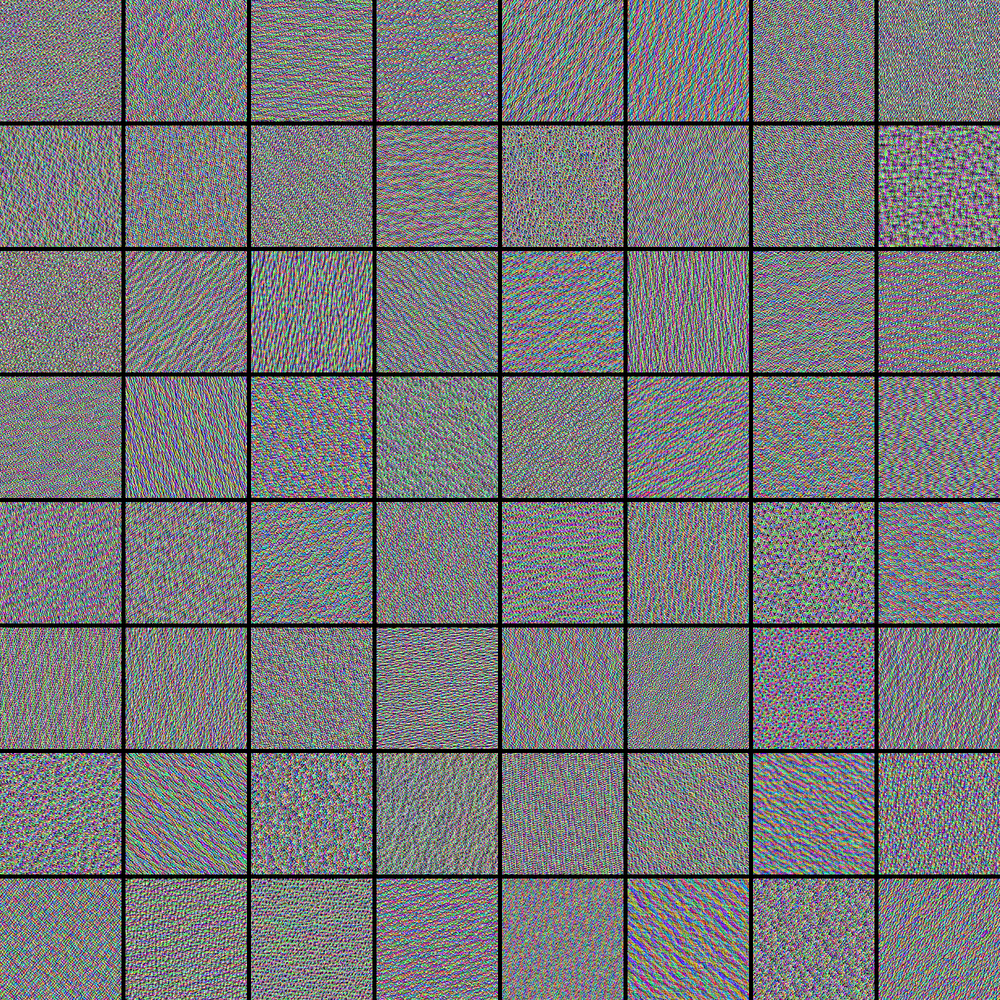

In [ ]:
from IPython.display import Image

Image(f"filters_for_layer_{layer_name}.png")

좀 더 깊은 차원 시도!

In [ ]:
layer_name = 'block14_sepconv1'
layer = xception.get_layer(name=layer_name)
feature_extractor = keras.Model(inputs=xception.input, outputs=layer.output)

avtivation = feature_extractor(keras.applications.xception.preprocess_input(img_tensor))

0번째 filter 처리 중
1번째 filter 처리 중
2번째 filter 처리 중
3번째 filter 처리 중
4번째 filter 처리 중
5번째 filter 처리 중
6번째 filter 처리 중
7번째 filter 처리 중
8번째 filter 처리 중
9번째 filter 처리 중
10번째 filter 처리 중
11번째 filter 처리 중
12번째 filter 처리 중
13번째 filter 처리 중
14번째 filter 처리 중
15번째 filter 처리 중
16번째 filter 처리 중
17번째 filter 처리 중
18번째 filter 처리 중
19번째 filter 처리 중
20번째 filter 처리 중
21번째 filter 처리 중
22번째 filter 처리 중
23번째 filter 처리 중
24번째 filter 처리 중
25번째 filter 처리 중
26번째 filter 처리 중
27번째 filter 처리 중
28번째 filter 처리 중
29번째 filter 처리 중
30번째 filter 처리 중
31번째 filter 처리 중
32번째 filter 처리 중
33번째 filter 처리 중
34번째 filter 처리 중
35번째 filter 처리 중
36번째 filter 처리 중
37번째 filter 처리 중
38번째 filter 처리 중
39번째 filter 처리 중
40번째 filter 처리 중
41번째 filter 처리 중
42번째 filter 처리 중
43번째 filter 처리 중
44번째 filter 처리 중
45번째 filter 처리 중
46번째 filter 처리 중
47번째 filter 처리 중
48번째 filter 처리 중
49번째 filter 처리 중
50번째 filter 처리 중
51번째 filter 처리 중
52번째 filter 처리 중
53번째 filter 처리 중
54번째 filter 처리 중
55번째 filter 처리 중
56번째 filter 처리 중
57번째 filter 처리 중
58번째 filter 처리 중
59번째 fi

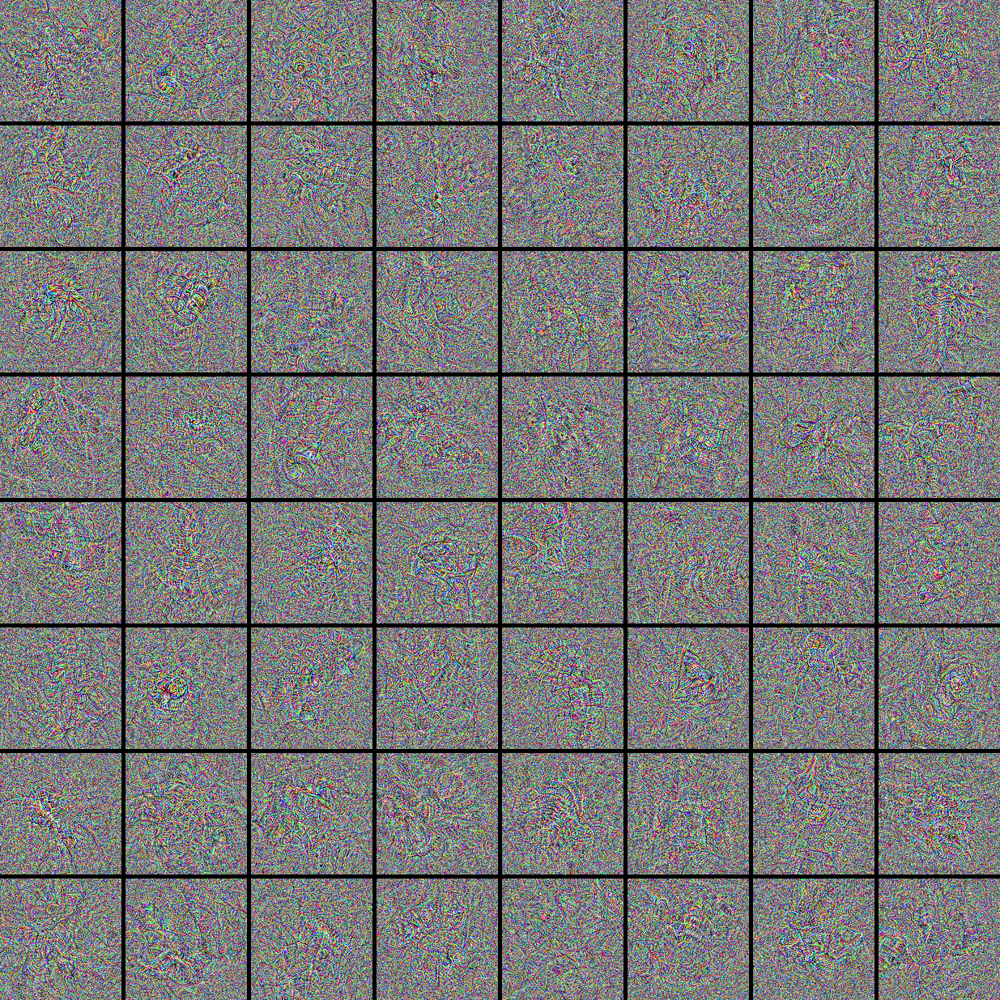

In [ ]:
all_images = []
for filter_index in range(64):
    print(f'{filter_index}번째 filter 처리 중')
    image = deprocess_image(generate_filter_pattern(filter_index))
    all_images.append(image)

margin = 5
n = 8
cropped_width = img_size[0] - 25*2
cropped_height = img_size[1] - 25*2
width = n * cropped_width + (n-1)*margin
height = n * cropped_height + (n-1)*margin
stitched_filters = np.zeros((width, height, 3))

for i in range(n):
    for j in range(n):
      image = all_images[i * n + j]
      stitched_filters[
          (cropped_width+margin)*i:(cropped_width+margin)*i+cropped_width,
          (cropped_height+margin)*j:(cropped_height+margin)*j+cropped_height, :
      ] = image

keras.utils.save_img(f'filters_for_layer_{layer_name}.png', stitched_filters)
Image(f"filters_for_layer_{layer_name}.png")

# 3. 클래스 활성화 히트맵

In [ ]:
xception = keras.applications.xception.Xception(weights="imagenet")

91884032/91884032 [==============================] - 1s 0us/step


In [ ]:
import numpy as np

img_path = keras.utils.get_file(fname='Aurora.jpg', origin='https://www.expedia.co.kr/stories/wp-content/uploads/2022/05/5-%ED%98%B8%EC%A3%BC-%ED%83%9C%EC%A6%88%EB%A7%A4%EB%8B%88%EC%95%84-4.jpg')

def get_img_array(img_path, target_size):
    img_array = keras.utils.img_to_array(keras.utils.load_img(img_path, target_size=target_size))
    img_array = np.expand_dims(img_array, axis=0)
    return img_array

img_tensor = keras.applications.xception.preprocess_input(get_img_array(img_path, (299, 299)))

820180/820180 [==============================] - 0s 0us/step


In [ ]:
preds = xception.predict(img_tensor)
print(keras.applications.xception.decode_predictions(preds, top=3)[0])
print(preds.shape)

1/1 [==============================] - 0s 394ms/step
[('n09472597', 'volcano', 0.19021624), ('n09428293', 'seashore', 0.08412539), ('n09288635', 'geyser', 0.033432465)]
(1, 1000)


In [ ]:
last_conv_layer_name = 'block14_sepconv2_act'
classifier_layers_names =['avg_pool', 'predictions']

last_conv_layer = xception.get_layer(last_conv_layer_name)
last_conv_layer_model = keras.Model(xception.inputs, last_conv_layer.output)

In [ ]:
classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
x = classifier_input
for layer_name in classifier_layers_names:
    x = xception.get_layer(layer_name)(x)
classifier_model = keras.Model(classifier_input, x)

In [ ]:
with tf.GradientTape() as tape:
    last_conv_layer_output = last_conv_layer_model(img_tensor)
    tape.watch(last_conv_layer_output)
    preds = classifier_model(last_conv_layer_output)
    top_pred_index = tf.argmax(preds[0])
    top_class_channel = preds[:, top_pred_index]

grads = tape.gradient(top_class_channel, last_conv_layer_output)

In [ ]:
pooled_grads = tf.reduce_mean(grads, axis=(0,1,2)).numpy()
last_conv_layer_output = last_conv_layer_output.numpy()[0]
last_conv_layer_output *= pooled_grads
heatmap = np.mean(last_conv_layer_output, axis=-1)

In [ ]:
import matplotlib.pyplot as plt


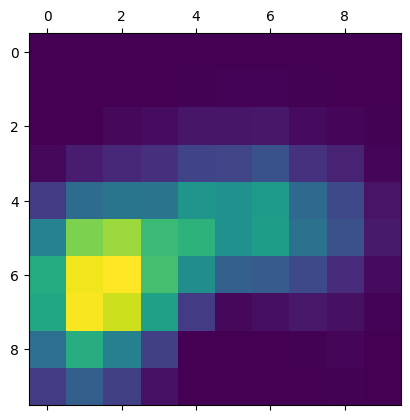

In [ ]:
heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
plt.matshow(heatmap)

<ipython-input-94-6eb53904c951>:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap('jet')


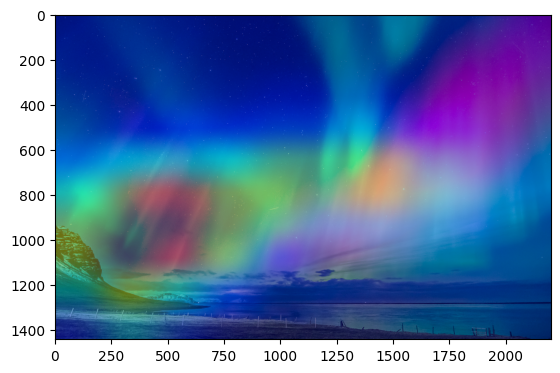

In [ ]:
import matplotlib.cm as cm

img = keras.utils.load_img(img_path)
img = keras.utils.img_to_array(img)
heatmap = np.uint8(255*heatmap)

jet = cm.get_cmap('jet')
jet_colors = jet(np.arange(256))[:, :3]
jet_heatmap = jet_colors[heatmap]

jet_heatmap = keras.utils.array_to_img(jet_heatmap)
jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
jet_heatmap = keras.utils.img_to_array(jet_heatmap)

superimposed_img = jet_heatmap * 0.8 + img
superimposed_img = keras.utils.array_to_img(superimposed_img)

save_path = 'Aurora.jpg'
superimposed_img.save(save_path)
plt.imshow(superimposed_img)